In [95]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap
from mpl_toolkits.axes_grid1 import make_axes_locatable


from ipywidgets import interact, fixed
from mpl_toolkits.mplot3d import Axes3D
import seaborn as sns
from matplotlib.patches import Ellipse
from scipy import linalg

#import plotly.express as px
import urllib.request
import zipfile
from matplotlib.colors import ListedColormap
import matplotlib.colors as mcolors
from matplotlib.ticker import FuncFormatter
from sklearn.decomposition import PCA, FactorAnalysis
from factor_analyzer import FactorAnalyzer, calculate_kmo, calculate_bartlett_sphericity
from sklearn.preprocessing import StandardScaler
from factor_analyzer import FactorAnalyzer

import os
# os.environ["OMP_NUM_THREADS"] = "2"

from sklearn.mixture import GaussianMixture
from sklearn.model_selection import GridSearchCV

from sklearn.datasets import make_regression
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor, RandomForestClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report, confusion_matrix, mean_absolute_percentage_error, mean_squared_error,r2_score

import pandas as pd
from sklearn.model_selection import cross_val_predict


import ast

from pathlib import Path  


from sklearn.cluster import KMeans
import geopandas as gpd

import matplotlib.patches as mpatches
from matplotlib.lines import Line2D


from adjustText import adjust_text
from matplotlib.patches import Patch


import warnings
warnings.filterwarnings("ignore", message="KMeans is known to have a memory leak")


In [63]:
msa_emissions = pd.read_csv('../../data/tidy/grouped-msa-total.csv') # modeshares (for commuting)
factors = pd.read_csv('../../data/tidy/factors-factoranalysis.csv') # modeshares (for commuting)
factors_df = pd.read_csv('../../data/tidy/raw-data-cleaned.csv')
raw = pd.read_csv('../../data/tidy/raw-data-cluster.csv')

In [64]:
# Assume df is your DataFrame
# Step 1: Separate the 'msa' and 'cluster' columns
msa_cluster = raw[['msa', 'Cluster']]
data_to_standardize = raw.drop(columns=['msa', 'Cluster'])

# Step 2: Standardize the remaining columns
scaler = StandardScaler()
standardized_data = scaler.fit_transform(data_to_standardize)

# Step 3: Create a new DataFrame with the standardized data
standardized_df = pd.DataFrame(standardized_data, columns=data_to_standardize.columns)

# Step 4: Add the 'msa' and 'cluster' columns back
raw = pd.concat([msa_cluster, standardized_df], axis=1)

In [65]:
data_to_standardize

,Node Count,Edge Count,Degree Average,Edge Length Total (km),Edge Length Average (km),Streets per Node Average,Intersection Count,Street Length Total (km),Street Segment Count,Street Length Average (km),...,Transit Other Fuel Vehicle Miles,Transit Electric Propulsion Vehicle Miles,Transit Electric Battery Vehicle Miles,Cooling Degree Days (°Df),Heating Degree Days (°Df),Palmer Z Index,Average Temperature (°F),Precipitation (in),Population Density (/sq km),Built-Up Area Proportion
0,14357.0,39401.0,5.488751,17168.965935,0.435749,2.881452,11912.0,8925.436120,20606.0,433.147439,...,0.0,0.0,0.0,2383.00,2332.000000,0.340000,65.000000,27.356667,24.019917,5.944727
1,26865.0,70900.0,5.278243,15191.985931,0.214273,2.756896,21200.0,8039.294972,36980.0,217.395754,...,0.0,0.0,0.0,823.00,5338.000000,0.165000,52.500000,40.550000,294.018910,38.222028
2,8466.0,22838.0,5.395228,9545.102272,0.417948,2.837468,6957.0,4989.592979,11954.0,417.399446,...,0.0,0.0,0.0,2546.75,1526.000000,0.547500,67.725000,58.845000,35.333378,9.334387
3,7132.0,17906.0,5.021312,8280.294430,0.462431,2.568144,5101.0,4225.438910,9147.0,461.948061,...,0.0,0.0,0.0,163.00,5550.000000,-0.350000,50.200000,65.670000,21.285743,3.662438
4,36977.0,96867.0,5.239311,27872.441864,0.287739,2.755794,30254.0,14555.424691,50900.0,285.961192,...,0.0,0.0,0.0,529.40,6367.200000,-0.396000,48.860000,37.660000,118.206895,15.468786
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
344,10920.0,28902.0,5.293407,14155.026874,0.489759,2.709982,8275.0,7249.500452,14773.0,490.726356,...,0.0,0.0,0.0,254.00,6455.000000,-0.860000,47.900000,22.810000,22.459825,20.914166
345,16622.0,44476.0,5.351462,13291.255851,0.298841,2.781194,13507.0,6831.204674,23064.0,296.184733,...,0.0,0.0,0.0,1050.00,4662.000000,-0.220000,55.000000,42.820000,189.847748,19.615869
346,24885.0,66650.0,5.356641,19738.540791,0.296152,2.794736,19982.0,10381.621775,34674.0,299.406523,...,0.0,0.0,0.0,643.00,5695.333333,0.783333,51.033333,45.596667,119.182102,20.344176
347,8419.0,21665.0,5.146692,7925.868395,0.365837,2.678465,6360.0,4094.273240,11260.0,363.612188,...,0.0,0.0,0.0,1969.50,2338.000000,-1.580000,63.950000,12.295000,53.631459,4.979487


In [66]:
extracted_df = factors_df[['msa', 'Population']]
extracted_df

,msa,Population
0,"Abilene, TX",171354
1,"Akron, OH",703286
2,"Albany, GA",147431
3,"Albany-Lebanon, OR",127216
4,"Albany-Schenectady-Troy, NY",880766
...,...,...
344,"Yakima, WA",250649
345,"York-Hanover, PA",447628
346,"Youngstown-Warren-Boardman, OH-PA",538115
347,"Yuba City, CA",173839


In [67]:
last_column_name = factors.columns[-1]

factors[last_column_name] = factors[last_column_name].astype('category')


In [68]:
#predicting emissions using random forest

In [69]:
# Standardize column names for merging
factors.rename(columns={'msa': 'MSA'}, inplace=True)

# Merge data on the 'MSA' column
data = pd.merge(msa_emissions, factors, on='MSA')

In [70]:
data

,MSA,carbon dioxide equivalent (Ton),Auto + Scale,Transit Propensity,Density,Sustainable Transit,Warm Weather,Remote + Active,Network Connectivity,Network Sprawl,Cluster
0,"Abilene, TX",1.604661e+06,-0.020769,-0.116631,-0.567720,-0.215719,1.024831,-0.196886,1.138187,1.305839,3
1,"Akron, OH",4.038062e+06,-0.595251,-0.032704,2.367134,0.181770,-0.714500,-0.538529,0.487787,-0.200201,7
2,"Albany, GA",1.062811e+06,-0.280811,0.056536,-0.590122,-0.044732,1.345877,-0.471593,0.828885,1.103606,3
3,"Albany-Lebanon, OR",9.640033e+05,-0.234983,0.067162,-1.131492,0.029690,-0.738241,-0.138377,-0.912521,0.868893,1
4,"Albany-Schenectady-Troy, NY",4.416599e+06,0.253770,-0.144994,0.279123,-0.278315,-1.043975,0.433586,0.400056,-0.411223,3
...,...,...,...,...,...,...,...,...,...,...,...
344,"Yakima, WA",1.345779e+06,0.055568,-0.016343,-1.304796,-0.044245,-1.032406,-0.639057,0.115356,0.847270,3
345,"York-Hanover, PA",2.087107e+06,-0.564581,0.064776,1.461622,0.149391,-0.349227,-0.563617,0.637335,0.441696,5
346,"Youngstown-Warren-Boardman, OH-PA",3.089513e+06,-0.082061,-0.059134,0.624753,-0.157510,-0.896252,-0.966299,0.642194,-0.369812,3
347,"Yuba City, CA",5.800871e+05,-0.398228,0.078186,-0.467446,-0.017681,0.861001,-0.215744,-0.064006,0.458856,5


In [71]:
# Merge DataFrames on the columns 'msa' and 'MSA'
merged_df = pd.merge(data, extracted_df, left_on='MSA', right_on='msa')

# Drop the duplicate 'MSA' column if needed
merged_df = merged_df.drop(columns=['msa'])

merged_df

,MSA,carbon dioxide equivalent (Ton),Auto + Scale,Transit Propensity,Density,Sustainable Transit,Warm Weather,Remote + Active,Network Connectivity,Network Sprawl,Cluster,Population
0,"Abilene, TX",1.604661e+06,-0.020769,-0.116631,-0.567720,-0.215719,1.024831,-0.196886,1.138187,1.305839,3,171354
1,"Akron, OH",4.038062e+06,-0.595251,-0.032704,2.367134,0.181770,-0.714500,-0.538529,0.487787,-0.200201,7,703286
2,"Albany, GA",1.062811e+06,-0.280811,0.056536,-0.590122,-0.044732,1.345877,-0.471593,0.828885,1.103606,3,147431
3,"Albany-Lebanon, OR",9.640033e+05,-0.234983,0.067162,-1.131492,0.029690,-0.738241,-0.138377,-0.912521,0.868893,1,127216
4,"Albany-Schenectady-Troy, NY",4.416599e+06,0.253770,-0.144994,0.279123,-0.278315,-1.043975,0.433586,0.400056,-0.411223,3,880766
...,...,...,...,...,...,...,...,...,...,...,...,...
344,"Yakima, WA",1.345779e+06,0.055568,-0.016343,-1.304796,-0.044245,-1.032406,-0.639057,0.115356,0.847270,3,250649
345,"York-Hanover, PA",2.087107e+06,-0.564581,0.064776,1.461622,0.149391,-0.349227,-0.563617,0.637335,0.441696,5,447628
346,"Youngstown-Warren-Boardman, OH-PA",3.089513e+06,-0.082061,-0.059134,0.624753,-0.157510,-0.896252,-0.966299,0.642194,-0.369812,3,538115
347,"Yuba City, CA",5.800871e+05,-0.398228,0.078186,-0.467446,-0.017681,0.861001,-0.215744,-0.064006,0.458856,5,173839


In [72]:
merged_df['Emissions per capita']=merged_df['carbon dioxide equivalent (Ton)']/merged_df['Population']
merged_df['carbon dioxide equivalent (MMTCO2e)']=merged_df['carbon dioxide equivalent (Ton)']/1102311.31

In [73]:
merged_df

,MSA,carbon dioxide equivalent (Ton),Auto + Scale,Transit Propensity,Density,Sustainable Transit,Warm Weather,Remote + Active,Network Connectivity,Network Sprawl,Cluster,Population,Emissions per capita,carbon dioxide equivalent (MMTCO2e)
0,"Abilene, TX",1.604661e+06,-0.020769,-0.116631,-0.567720,-0.215719,1.024831,-0.196886,1.138187,1.305839,3,171354,9.364594,1.455724
1,"Akron, OH",4.038062e+06,-0.595251,-0.032704,2.367134,0.181770,-0.714500,-0.538529,0.487787,-0.200201,7,703286,5.741707,3.663268
2,"Albany, GA",1.062811e+06,-0.280811,0.056536,-0.590122,-0.044732,1.345877,-0.471593,0.828885,1.103606,3,147431,7.208870,0.964166
3,"Albany-Lebanon, OR",9.640033e+05,-0.234983,0.067162,-1.131492,0.029690,-0.738241,-0.138377,-0.912521,0.868893,1,127216,7.577689,0.874529
4,"Albany-Schenectady-Troy, NY",4.416599e+06,0.253770,-0.144994,0.279123,-0.278315,-1.043975,0.433586,0.400056,-0.411223,3,880766,5.014498,4.006672
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
344,"Yakima, WA",1.345779e+06,0.055568,-0.016343,-1.304796,-0.044245,-1.032406,-0.639057,0.115356,0.847270,3,250649,5.369176,1.220870
345,"York-Hanover, PA",2.087107e+06,-0.564581,0.064776,1.461622,0.149391,-0.349227,-0.563617,0.637335,0.441696,5,447628,4.662592,1.893391
346,"Youngstown-Warren-Boardman, OH-PA",3.089513e+06,-0.082061,-0.059134,0.624753,-0.157510,-0.896252,-0.966299,0.642194,-0.369812,3,538115,5.741362,2.802759
347,"Yuba City, CA",5.800871e+05,-0.398228,0.078186,-0.467446,-0.017681,0.861001,-0.215744,-0.064006,0.458856,5,173839,3.336922,0.526246


In [74]:
raw['Emissions per capita']=merged_df['Emissions per capita']
raw['carbon dioxide equivalent (MMTCO2e)']=merged_df['carbon dioxide equivalent (MMTCO2e)']
# raw['Emissions per capita (MTCO2e)']=raw['Emissions per capita']*0.91

In [75]:
raw.columns

raw = raw.rename(columns={
    'Street length total (km)': 'Street Length (km)',
    'Intersection density (per sq km)': 'Intersection Density (per sq km)',
    'Street density (km/sq km)': 'Street Density (km/sq km)',
    'Building area (sq km)': 'Building Area (sq km)',
    'Median Income': 'Median Income ($)',
    'Total population': 'Population',
    'Total housing units': 'Housing Units',
    '1 vehicle available': '1 Vehicle Available',
    '2 vehicle available': '2 Vehicle Available',
    '3 or more vehicle available': '3 or More Vehicle Available',
    'No vehicle available': 'No Vehicle Available',
    'GDP': 'GDP ($)',
    'Population density (people/sq km)': 'Population Density (people/sq km)',
    'Car, truck, or van:': 'Personal Vehicle (mode share %)',
    'Public transportation (excluding taxicab):':'Public Transportation (mode share %)',
    'Bicycle':'Bicycle (mode share %)',
    'Walked':'Walked (mode share %)',
    'Worked from home':'Worked from Home (mode share %)',
    'Employment Rate':'Employment Rate (%)',
    'Unemployment Rate':'Unemployment Rate (%)',
    'Liquefied Petroleum Gas (gal equivalent)':'Liquefied Petroleum Gas (GGE)',
    'Compressed Natural Gas (gal equivalent)':'Compressed Natural Gas (GGE)',
    'Other Fuel (gal/gal equivalent)':'Other Fuel (GGE)',
    'Node count':'Node Count',
    'Edge count':'Edge Count',
    'Degree average':'Degree Average',
    'Edge length total (km)':'Edge Length Total (km)',
    'Edge length average (km)':'Edge Length Average (km)',
    'Streets per node average':'Streets per Node Average',
    'Intersection count':'Intersection Count',
    'Street length total (km)':'Street Length Total (km)',
    'Street segment count':'Street Segment Count',
    'Street length average (km)':'Street Length Average (km)',
    'Circuity average':'Circuity Average',
    'Self-loop proportion':'Self-loop Proportion',
    'Node density (per sq km)':'Node Density (per sq km)',
    'Intersection density (per sq km)':'Intersection Density (per sq km)',
    'Edge density (km/sq km)':'Edge Density (km/sq km)',
    'Street density (km/sq km)':'Street Density (km/sq km)',
    'Building area (sq km)':'Building Area (sq km)'
})

In [76]:
new_df = merged_df.copy()
new_df

,MSA,carbon dioxide equivalent (Ton),Auto + Scale,Transit Propensity,Density,Sustainable Transit,Warm Weather,Remote + Active,Network Connectivity,Network Sprawl,Cluster,Population,Emissions per capita,carbon dioxide equivalent (MMTCO2e)
0,"Abilene, TX",1.604661e+06,-0.020769,-0.116631,-0.567720,-0.215719,1.024831,-0.196886,1.138187,1.305839,3,171354,9.364594,1.455724
1,"Akron, OH",4.038062e+06,-0.595251,-0.032704,2.367134,0.181770,-0.714500,-0.538529,0.487787,-0.200201,7,703286,5.741707,3.663268
2,"Albany, GA",1.062811e+06,-0.280811,0.056536,-0.590122,-0.044732,1.345877,-0.471593,0.828885,1.103606,3,147431,7.208870,0.964166
3,"Albany-Lebanon, OR",9.640033e+05,-0.234983,0.067162,-1.131492,0.029690,-0.738241,-0.138377,-0.912521,0.868893,1,127216,7.577689,0.874529
4,"Albany-Schenectady-Troy, NY",4.416599e+06,0.253770,-0.144994,0.279123,-0.278315,-1.043975,0.433586,0.400056,-0.411223,3,880766,5.014498,4.006672
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
344,"Yakima, WA",1.345779e+06,0.055568,-0.016343,-1.304796,-0.044245,-1.032406,-0.639057,0.115356,0.847270,3,250649,5.369176,1.220870
345,"York-Hanover, PA",2.087107e+06,-0.564581,0.064776,1.461622,0.149391,-0.349227,-0.563617,0.637335,0.441696,5,447628,4.662592,1.893391
346,"Youngstown-Warren-Boardman, OH-PA",3.089513e+06,-0.082061,-0.059134,0.624753,-0.157510,-0.896252,-0.966299,0.642194,-0.369812,3,538115,5.741362,2.802759
347,"Yuba City, CA",5.800871e+05,-0.398228,0.078186,-0.467446,-0.017681,0.861001,-0.215744,-0.064006,0.458856,5,173839,3.336922,0.526246


In [77]:
new_df['Emissions per capita (MTCO2e)']=new_df['Emissions per capita']*0.91

In [78]:

cluster_mapping = {
    1: 'Sparse Active',
    2: 'Heavyweight Transit',
    3: 'Sparse Auto',
    4: 'Auto Large',
    5: 'Auto Small',
    6: 'Heavyweight Eco-Transit',
    7: 'Dense Active'
}



# Replace numerical cluster values with names in the new DataFrame
new_df['Cluster'] = new_df['Cluster'].replace(cluster_mapping)

C:\Users\peiyaozhao\AppData\Local\Temp\ipykernel_11804\2310693843.py:14: FutureWarning: The behavior of Series.replace (and DataFrame.replace) with CategoricalDtype is deprecated. In a future version, replace will only be used for cases that preserve the categories. To change the categories, use ser.cat.rename_categories instead.
  new_df['Cluster'] = new_df['Cluster'].replace(cluster_mapping)


C:\Users\peiyaozhao\AppData\Local\Temp\ipykernel_11804\375653287.py:7: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.boxplot(x='carbon dioxide equivalent (MMTCO2e)', y='Cluster', data=new_df, palette=custom_palette)


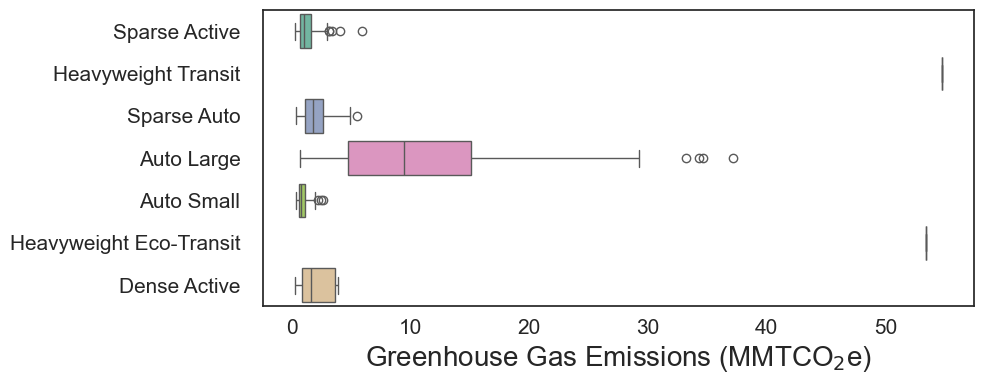

In [79]:


# Define custom color palette
custom_palette = ['#66c2a5', '#fc8d62', '#8da0cb', '#e78ac3', '#a6d854', '#ffd92f','#e5c494']
color_iter = ListedColormap(custom_palette)

# Plot
plt.figure(figsize=(10, 4))  # Increase the size for better visibility
ax = sns.boxplot(x='carbon dioxide equivalent (MMTCO2e)', y='Cluster', data=new_df, palette=custom_palette)

# Customize labels and ticks
plt.xlabel('Greenhouse Gas Emissions (MMTCO$_2$e)', fontsize=20)
plt.ylabel('', fontsize=20)
plt.yticks(fontsize=15)
plt.xticks(fontsize=15)

# Adjust label padding
ax.tick_params(axis='y', pad=10)  # Increase padding if needed

# Adjust layout
plt.tight_layout()

# Save the figure with higher DPI
plt.savefig('../../figures/cluster-emissions-boxplot.jpg', dpi=600)

# Show the plot
plt.show()


C:\Users\peiyaozhao\AppData\Local\Temp\ipykernel_11804\2613214643.py:36: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.boxenplot(x='Emissions per capita (MTCO2e)', y='Cluster', data=new_df, palette=custom_palette,order=list(color_mapping.keys()) )


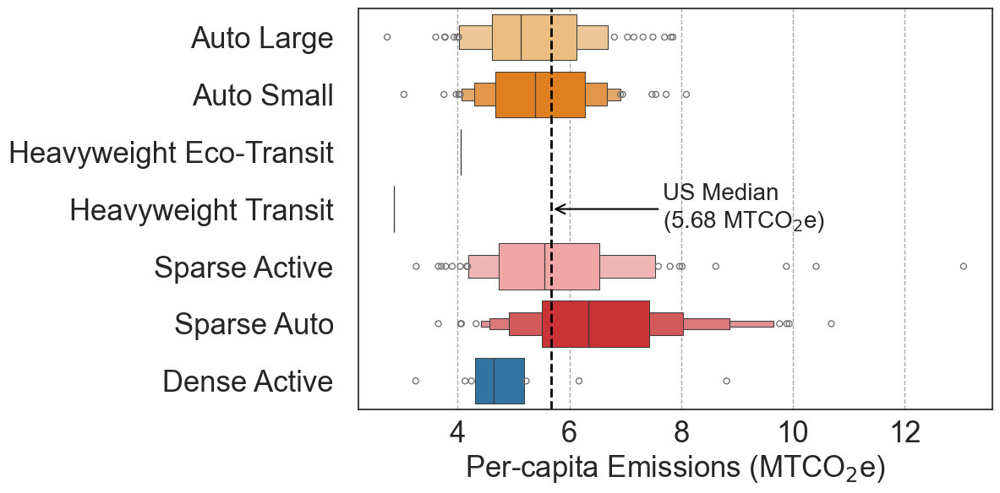

In [80]:
global_median = new_df['Emissions per capita (MTCO2e)'].median()


cluster_mapping = {
    4: 'Auto Large',
    5: 'Auto Small',
    7: 'Dense Active',
    6: 'Heavyweight Eco-Transit',
    2: 'Heavyweight Transit',
    1: 'Sparse Active',
    3: 'Sparse Auto'
}

color_mapping = {
    'Auto Large': '#FDBF6F',
    'Auto Small': '#FF7F00',
    'Heavyweight Eco-Transit': '#B2DF8A',
    'Heavyweight Transit': '#33A02C',
    'Sparse Active': '#FB9A99',
    'Sparse Auto': '#E31A1C',
    'Dense Active': '#1F78B4'  # Dense Active at the end
}



# Custom palette
custom_palette = ['#FDBF6F', '#FF7F00', '#B2DF8A', '#33A02C', '#FB9A99', '#E31A1C', '#1F78B4']


# Define custom color palette
# custom_palette = ['#7fc97f', '#beaed4', '#fdc086', '#ffff99', '#386cb0', '#f0027f','#bf5b17']
color_iter = ListedColormap(custom_palette)

# Plot
plt.figure(figsize=(12, 6))
ax = sns.boxenplot(x='Emissions per capita (MTCO2e)', y='Cluster', data=new_df, palette=custom_palette,order=list(color_mapping.keys()) )

# Add vertical grid lines
plt.grid(axis='x', linestyle='--', color='gray', alpha=0.7)

# Add vertical line for the global median
plt.axvline(x=global_median, color='black', linestyle='--', linewidth=2)

# Add an arrow annotation pointing to the vertical line
plt.annotate(
    'US Median\n({:.2f} MTCO$_2$e)'.format(global_median),  # Multi-line label
    xy=(global_median, 3),  # Arrow's head (x-coordinate at median, y in data coordinates)
    xytext=(global_median + 2, 3),  # Position of the label (adjust as needed)
    arrowprops=dict(arrowstyle='->', color='black', linewidth=1.5),
    fontsize=20,
    ha='left',
    va='center'
)

# Customize labels and ticks
plt.xlabel('Per-capita Emissions (MTCO$_2$e)', fontsize=25)
plt.ylabel('', fontsize=25)
plt.yticks(fontsize=25)
plt.xticks(fontsize=25)

# Adjust label padding
ax.tick_params(axis='y', pad=15)  # Increase padding if needed

# Adjust layout
plt.tight_layout()

# Save the figure
plt.savefig('../../figures/cluster-emissions-per-capita-boxenplot.jpg', dpi=600)

# Show the plot
plt.show()


In [81]:

new_df.to_csv('../../results/cluster-msa-emissions.csv',index=False)
new_df

,MSA,carbon dioxide equivalent (Ton),Auto + Scale,Transit Propensity,Density,Sustainable Transit,Warm Weather,Remote + Active,Network Connectivity,Network Sprawl,Cluster,Population,Emissions per capita,carbon dioxide equivalent (MMTCO2e),Emissions per capita (MTCO2e)
0,"Abilene, TX",1.604661e+06,-0.020769,-0.116631,-0.567720,-0.215719,1.024831,-0.196886,1.138187,1.305839,Sparse Auto,171354,9.364594,1.455724,8.521780
1,"Akron, OH",4.038062e+06,-0.595251,-0.032704,2.367134,0.181770,-0.714500,-0.538529,0.487787,-0.200201,Dense Active,703286,5.741707,3.663268,5.224953
2,"Albany, GA",1.062811e+06,-0.280811,0.056536,-0.590122,-0.044732,1.345877,-0.471593,0.828885,1.103606,Sparse Auto,147431,7.208870,0.964166,6.560072
3,"Albany-Lebanon, OR",9.640033e+05,-0.234983,0.067162,-1.131492,0.029690,-0.738241,-0.138377,-0.912521,0.868893,Sparse Active,127216,7.577689,0.874529,6.895697
4,"Albany-Schenectady-Troy, NY",4.416599e+06,0.253770,-0.144994,0.279123,-0.278315,-1.043975,0.433586,0.400056,-0.411223,Sparse Auto,880766,5.014498,4.006672,4.563193
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
344,"Yakima, WA",1.345779e+06,0.055568,-0.016343,-1.304796,-0.044245,-1.032406,-0.639057,0.115356,0.847270,Sparse Auto,250649,5.369176,1.220870,4.885950
345,"York-Hanover, PA",2.087107e+06,-0.564581,0.064776,1.461622,0.149391,-0.349227,-0.563617,0.637335,0.441696,Auto Small,447628,4.662592,1.893391,4.242959
346,"Youngstown-Warren-Boardman, OH-PA",3.089513e+06,-0.082061,-0.059134,0.624753,-0.157510,-0.896252,-0.966299,0.642194,-0.369812,Sparse Auto,538115,5.741362,2.802759,5.224640
347,"Yuba City, CA",5.800871e+05,-0.398228,0.078186,-0.467446,-0.017681,0.861001,-0.215744,-0.064006,0.458856,Auto Small,173839,3.336922,0.526246,3.036599


In [82]:
# Replace 'your_shapefile_path' with the path to your shapefile
gdf = gpd.read_file('../../data/raw/cb_2018_us_cbsa_500k/cb_2018_us_cbsa_500k.shp')
us_state = gpd.read_file('../../data/raw/cb_2018_us_state_500k/cb_2018_us_state_500k.shp')
# Filter for Metropolitan Statistical Areas (MSA)
msa_gdf = gdf[(gdf['CBSAFP'].notnull()) & (gdf['LSAD'] == 'M1')]

# Extract city and state from NAME in df2
msa_gdf[['Area', 'State']] = msa_gdf['NAME'].str.split(', ', expand=True)
msa_gdf['Area'] = msa_gdf['Area'].str.split('-').str[0]
msa_gdf

C:\Users\peiyaozhao\AppData\Local\anaconda3\Lib\site-packages\geopandas\geodataframe.py:1543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)
C:\Users\peiyaozhao\AppData\Local\anaconda3\Lib\site-packages\geopandas\geodataframe.py:1543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)


,CSAFP,CBSAFP,AFFGEOID,GEOID,NAME,LSAD,ALAND,AWATER,geometry,Area,State
0,None,31340,310M400US31340,31340,"Lynchburg, VA",M1,5491925729,68559452,"POLYGON ((-79.85840 37.26715, -79.85660 37.268...",Lynchburg,VA
1,488,42220,310M400US42220,42220,"Santa Rosa, CA",M1,4081491107,497455304,"POLYGON ((-123.53354 38.76841, -123.52851 38.7...",Santa Rosa,CA
3,538,46140,310M400US46140,46140,"Tulsa, OK",M1,16238554204,492994165,"POLYGON ((-97.06448 36.68106, -97.06411 36.684...",Tulsa,OK
5,None,41740,310M400US41740,41740,"San Diego-Carlsbad, CA",M1,10900649391,820695499,"POLYGON ((-117.59615 33.38717, -117.59360 33.3...",San Diego,CA
8,340,38220,310M400US38220,38220,"Pine Bluff, AR",M1,5255934204,143446207,"POLYGON ((-92.47391 34.00623, -92.47241 34.038...",Pine Bluff,AR
...,...,...,...,...,...,...,...,...,...,...,...
934,None,42020,310M400US42020,42020,"San Luis Obispo-Paso Robles-Arroyo Grande, CA",M1,8548611925,815519172,"POLYGON ((-121.34636 35.79518, -121.24378 35.7...",San Luis Obispo,CA
936,None,49740,310M400US49740,49740,"Yuma, AZ",M1,14281127830,13326079,"POLYGON ((-114.81629 32.50804, -114.81432 32.5...",Yuma,AZ
938,222,20020,310M400US20020,20020,"Dothan, AL",M1,4444678880,33248036,"POLYGON ((-86.19348 31.19221, -86.14167 31.192...",Dothan,AL
939,408,14860,310M400US14860,14860,"Bridgeport-Stamford-Norwalk, CT",M1,1618651428,549293518,"MULTIPOLYGON (((-73.21717 41.14391, -73.21611 ...",Bridgeport,CT


In [83]:
if isinstance(divid_df.columns, pd.MultiIndex):
    divid_df.columns = divid_df.columns.get_level_values(0)
if isinstance(msa_gdf.columns, pd.MultiIndex):
    msa_gdf.columns = msa_gdf.columns.get_level_values(0)

# Merge the dataframes on the 'Area' and 'State' columns
merged_df = msa_gdf.merge(divid_df, on=['Area', 'State'], suffixes=('_pivot', '_msa'))
merged_df

,CSAFP,CBSAFP,AFFGEOID,GEOID,NAME,LSAD,ALAND,AWATER,geometry,Area,...,carbon dioxide equivalent (Ton),Auto + Scale,Transit Propensity,Density,Sustainable Transit,Warm Weather,Remote + Active,Network Connectivity,Network Sprawl,Cluster
0,488,42220,310M400US42220,42220,"Santa Rosa, CA",M1,4081491107,497455304,"POLYGON ((-123.53354 38.76841, -123.52851 38.7...",Santa Rosa,...,2.130224e+06,-0.421319,0.027996,-0.261006,0.126456,0.180328,1.053644,-1.263948,-0.974766,1
1,538,46140,310M400US46140,46140,"Tulsa, OK",M1,16238554204,492994165,"POLYGON ((-97.06448 36.68106, -97.06411 36.684...",Tulsa,...,6.939685e+06,1.253874,-0.557184,-0.447545,-0.487884,0.090524,-1.106866,-0.060996,-0.654927,4
2,None,41740,310M400US41740,41740,"San Diego-Carlsbad, CA",M1,10900649391,820695499,"POLYGON ((-117.59615 33.38717, -117.59360 33.3...",San Diego,...,1.673588e+07,0.612938,0.062172,-0.073553,2.245876,0.773619,1.325500,-0.763421,-0.782388,4
3,340,38220,310M400US38220,38220,"Pine Bluff, AR",M1,5255934204,143446207,"POLYGON ((-92.47391 34.00623, -92.47241 34.038...",Pine Bluff,...,7.791471e+05,-0.138736,0.062865,-0.593285,-0.101650,0.645319,-1.359687,-0.540911,0.899830,3
4,None,17020,310M400US17020,17020,"Chico, CA",M1,4238438186,105311003,"POLYGON ((-122.06874 39.84222, -122.06694 39.8...",Chico,...,1.182906e+06,-0.397955,0.028201,-0.372676,-0.048869,0.740048,0.717149,-1.326627,0.370626,3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
341,None,42020,310M400US42020,42020,"San Luis Obispo-Paso Robles-Arroyo Grande, CA",M1,8548611925,815519172,"POLYGON ((-121.34636 35.79518, -121.24378 35.7...",San Luis Obispo,...,1.256077e+06,-0.277810,-0.019631,-1.107914,-0.052392,0.567674,1.522081,-0.792488,-0.184363,1
342,None,49740,310M400US49740,49740,"Yuma, AZ",M1,14281127830,13326079,"POLYGON ((-114.81629 32.50804, -114.81432 32.5...",Yuma,...,1.288764e+06,-0.135401,0.015529,-1.522632,-0.153616,2.392211,0.294441,1.447098,0.081042,3
343,222,20020,310M400US20020,20020,"Dothan, AL",M1,4444678880,33248036,"POLYGON ((-86.19348 31.19221, -86.14167 31.192...",Dothan,...,1.124121e+06,-0.180688,0.028158,-0.302815,-0.127031,1.246348,-1.290599,0.473791,0.624579,3
344,408,14860,310M400US14860,14860,"Bridgeport-Stamford-Norwalk, CT",M1,1618651428,549293518,"MULTIPOLYGON (((-73.21717 41.14391, -73.21611 ...",Bridgeport,...,4.288006e+06,-0.990514,-0.089672,4.260506,-0.003983,-0.379583,1.974780,-0.342436,1.537504,7


In [84]:
merged_df['Emissions per capita']=new_df['Emissions per capita (MTCO2e)']

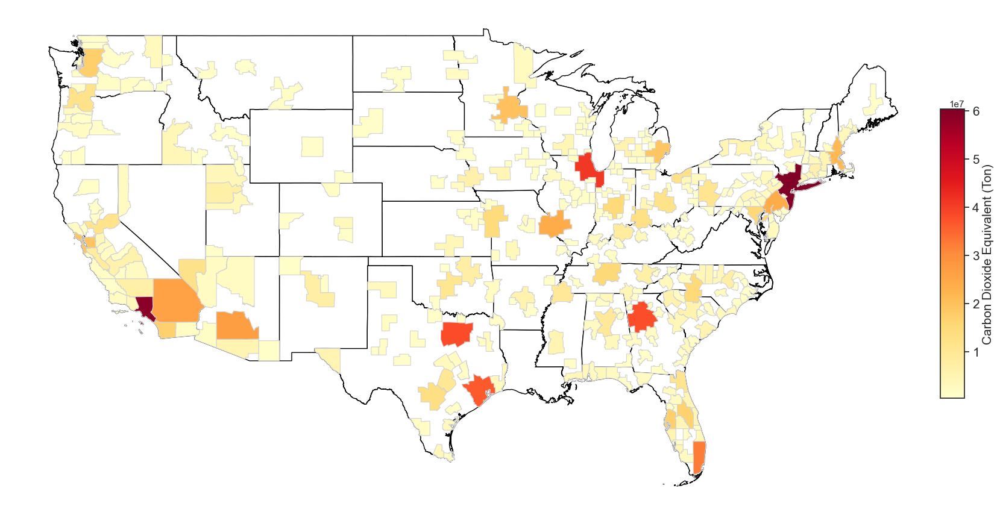

In [85]:
import matplotlib.pyplot as plt
import geopandas as gpd
import seaborn as sns

# Ensure both DataFrames use the same CRS
us_state = us_state.to_crs(epsg=4326)
merged_df = merged_df.to_crs(epsg=4326)

# Filter out Alaska
us_state = us_state[us_state['NAME'] != 'Alaska']

# Calculate the bounding box that covers both DataFrames
minx, miny, maxx, maxy = merged_df.total_bounds
us_state = us_state.cx[minx:maxx, miny:maxy]

# Plot the heatmap with town boundaries
fig, ax = plt.subplots(1, 1, figsize=(20, 12))
ax.set_axis_off()
us_state.plot(ax=ax, color='white', edgecolor='black')  # Plot town boundaries

# Plot the heatmap with adjusted boundary color
merged_df.plot(column='carbon dioxide equivalent (Ton)', cmap='YlOrRd', linewidth=0.8, ax=ax, edgecolor='lightgray')  # Plot heatmap

# Add colorbar with a smaller size
cax = fig.add_axes([0.9, 0.3, 0.02, 0.4])
sm = plt.cm.ScalarMappable(cmap='YlOrRd', norm=plt.Normalize(vmin=merged_df['carbon dioxide equivalent (Ton)'].min(), vmax=merged_df['carbon dioxide equivalent (Ton)'].max()))
sm._A = []
colorbar = fig.colorbar(sm, cax=cax)

# Add unit label to the colorbar
colorbar.set_label('Carbon Dioxide Equivalent (Ton)', size=15)

colorbar.ax.tick_params(labelsize=15)

#ax.set_title('Carbon Dioxide Equivalent Heatmap with MSA Boundaries', fontsize=20)

plt.savefig('../../figures/carbondioxide-heatmap.png', dpi=360)



In [86]:
merged_df.columns

Index(['CSAFP', 'CBSAFP', 'AFFGEOID', 'GEOID', 'NAME', 'LSAD', 'ALAND',
       'AWATER', 'geometry', 'Area', 'State', 'MSA',
       'carbon dioxide equivalent (Ton)', 'Auto + Scale', 'Transit Propensity',
       'Density', 'Sustainable Transit', 'Warm Weather', 'Remote + Active',
       'Network Connectivity', 'Network Sprawl', 'Cluster',
       'Emissions per capita'],
      dtype='object')

In [87]:
merged_df['greenhouse gas emissions (MMTCO2e)']=merged_df['carbon dioxide equivalent (Ton)']/1102311.31

In [88]:
merged_df

,CSAFP,CBSAFP,AFFGEOID,GEOID,NAME,LSAD,ALAND,AWATER,geometry,Area,...,Transit Propensity,Density,Sustainable Transit,Warm Weather,Remote + Active,Network Connectivity,Network Sprawl,Cluster,Emissions per capita,greenhouse gas emissions (MMTCO2e)
0,488,42220,310M400US42220,42220,"Santa Rosa, CA",M1,4081491107,497455304,"POLYGON ((-123.53354 38.76841, -123.52851 38.7...",Santa Rosa,...,0.027996,-0.261006,0.126456,0.180328,1.053644,-1.263948,-0.974766,1,8.521780,1.932506
1,538,46140,310M400US46140,46140,"Tulsa, OK",M1,16238554204,492994165,"POLYGON ((-97.06448 36.68106, -97.06411 36.684...",Tulsa,...,-0.557184,-0.447545,-0.487884,0.090524,-1.106866,-0.060996,-0.654927,4,5.224953,6.295576
2,None,41740,310M400US41740,41740,"San Diego-Carlsbad, CA",M1,10900649391,820695499,"POLYGON ((-117.59615 33.38717, -117.59360 33.3...",San Diego,...,0.062172,-0.073553,2.245876,0.773619,1.325500,-0.763421,-0.782388,4,6.560072,15.182534
3,340,38220,310M400US38220,38220,"Pine Bluff, AR",M1,5255934204,143446207,"POLYGON ((-92.47391 34.00623, -92.47241 34.038...",Pine Bluff,...,0.062865,-0.593285,-0.101650,0.645319,-1.359687,-0.540911,0.899830,3,6.895697,0.706830
4,None,17020,310M400US17020,17020,"Chico, CA",M1,4238438186,105311003,"POLYGON ((-122.06874 39.84222, -122.06694 39.8...",Chico,...,0.028201,-0.372676,-0.048869,0.740048,0.717149,-1.326627,0.370626,3,4.563193,1.073115
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
341,None,42020,310M400US42020,42020,"San Luis Obispo-Paso Robles-Arroyo Grande, CA",M1,8548611925,815519172,"POLYGON ((-121.34636 35.79518, -121.24378 35.7...",San Luis Obispo,...,-0.019631,-1.107914,-0.052392,0.567674,1.522081,-0.792488,-0.184363,1,4.611721,1.139494
342,None,49740,310M400US49740,49740,"Yuma, AZ",M1,14281127830,13326079,"POLYGON ((-114.81629 32.50804, -114.81432 32.5...",Yuma,...,0.015529,-1.522632,-0.153616,2.392211,0.294441,1.447098,0.081042,3,5.512735,1.169147
343,222,20020,310M400US20020,20020,"Dothan, AL",M1,4444678880,33248036,"POLYGON ((-86.19348 31.19221, -86.14167 31.192...",Dothan,...,0.028158,-0.302815,-0.127031,1.246348,-1.290599,0.473791,0.624579,3,4.528186,1.019785
344,408,14860,310M400US14860,14860,"Bridgeport-Stamford-Norwalk, CT",M1,1618651428,549293518,"MULTIPOLYGON (((-73.21717 41.14391, -73.21611 ...",Bridgeport,...,-0.089672,4.260506,-0.003983,-0.379583,1.974780,-0.342436,1.537504,7,4.885950,3.890013


In [89]:
# Set the theme
sns.set_theme(style="white")

# Create the figure and axis
fig, ax = plt.subplots(figsize=(30, 20), dpi=600)

# Ensure both DataFrames use the same CRS
us_state = us_state.to_crs(epsg=4326)
merged_df = merged_df.to_crs(epsg=4326)

# Filter out Alaska
us_state = us_state[us_state['NAME'] != 'Alaska']

us_state.plot(ax=ax, alpha=0.2, facecolor='white', edgecolor='black')

# Plot the heatmap with adjusted boundary color
merged_df.plot(ax=ax, alpha=0.8, column='greenhouse gas emissions (MMTCO2e)', cmap='YlOrRd', legend=False, edgecolor='black', linewidth=0.5)

# Customize the plot
plt.xlabel('')
plt.ylabel('')
plt.title('')
plt.xlim(-128, -60)
plt.ylim(20, 50)
plt.grid(False)
plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['bottom'].set_visible(False)
plt.gca().spines['left'].set_visible(False)
plt.tick_params(axis='both', which='both', length=0)
plt.tick_params(axis='both', which='both', labelsize=0)

# Add colorbar with a smaller size
cax = fig.add_axes([0.2, 0.18, 0.6, 0.04])
sm = plt.cm.ScalarMappable(cmap='YlOrRd', norm=plt.Normalize(vmin=merged_df['greenhouse gas emissions (MMTCO2e)'].min(), vmax=merged_df['greenhouse gas emissions (MMTCO2e)'].max()))
sm._A = []
colorbar = fig.colorbar(sm, cax=cax, orientation='horizontal')

# Add unit label to the colorbar
colorbar.set_label('Greenhouse Gas Emissions (MMTCO$_{2}$e)', size=30)

colorbar.ax.tick_params(labelsize=20)

# Adjust layout to minimize white space
plt.tight_layout()

# Optionally, adjust subplot parameters to further reduce white space
fig.subplots_adjust(left=0.05, right=0.95, top=0.95, bottom=0.05)

#ax.set_title('Carbon Dioxide Equivalent Heatmap with MSA Boundaries', fontsize=20)

plt.savefig('../../figures/greenhousegas-heatmap.jpg', dpi=600)

C:\Users\peiyaozhao\AppData\Local\Temp\ipykernel_11804\3969700091.py:45: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


In [90]:
# Set the theme
sns.set_theme(style="white")

# Create the figure and axis
fig, ax = plt.subplots(figsize=(30, 20), dpi=600)

# Ensure both DataFrames use the same CRS
us_state = us_state.to_crs(epsg=4326)
merged_df = merged_df.to_crs(epsg=4326)

# Filter out Alaska
us_state = us_state[us_state['NAME'] != 'Alaska']

us_state.plot(ax=ax, alpha=0.2, facecolor='white', edgecolor='black')

# Plot the heatmap with adjusted boundary color
merged_df.plot(ax=ax, alpha=0.8, column='Emissions per capita', cmap='YlOrRd', legend=False, edgecolor='black', linewidth=0.5)

# Customize the plot
plt.xlabel('')
plt.ylabel('')
plt.title('')
plt.xlim(-128, -60)
plt.ylim(20, 50)
plt.grid(False)
plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['bottom'].set_visible(False)
plt.gca().spines['left'].set_visible(False)
plt.tick_params(axis='both', which='both', length=0)
plt.tick_params(axis='both', which='both', labelsize=0)

# Add colorbar with a smaller size
cax = fig.add_axes([0.2, 0.18, 0.6, 0.04])
sm = plt.cm.ScalarMappable(cmap='YlOrRd', norm=plt.Normalize(vmin=merged_df['Emissions per capita'].min(), vmax=merged_df['Emissions per capita'].max()))
sm._A = []
colorbar = fig.colorbar(sm, cax=cax, orientation='horizontal')

# Add unit label to the colorbar
colorbar.set_label('Greenhouse Gas Per-capita Emissions (MTCO$_{2}$e)', size=30)

colorbar.ax.tick_params(labelsize=20)

# Adjust layout to minimize white space
plt.tight_layout()

# Optionally, adjust subplot parameters to further reduce white space
fig.subplots_adjust(left=0.05, right=0.95, top=0.95, bottom=0.05)

#ax.set_title('Carbon Dioxide Equivalent Heatmap with MSA Boundaries', fontsize=20)

plt.savefig('../../figures/greenhousegas-per-capita-heatmap.jpg', dpi=600)

C:\Users\peiyaozhao\AppData\Local\Temp\ipykernel_11804\2773226980.py:45: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


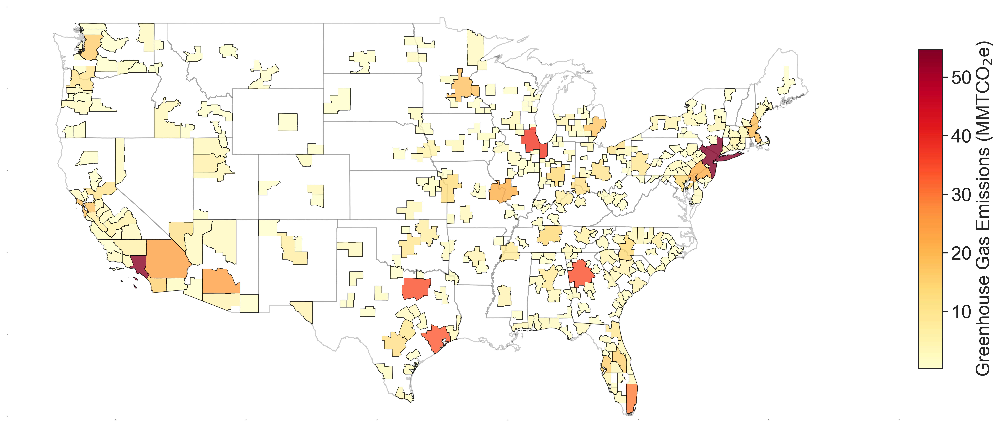

In [91]:
# Set the theme
sns.set_theme(style="white")

# Create the figure and axis
fig, ax = plt.subplots(figsize=(18, 8), dpi=600)

# Ensure both DataFrames use the same CRS
us_state = us_state.to_crs(epsg=4326)
merged_df = merged_df.to_crs(epsg=4326)

# Filter out Alaska
us_state = us_state[us_state['NAME'] != 'Alaska']




us_state.plot(ax=ax, alpha=0.2, facecolor='white', edgecolor='black')

# Plot the heatmap with adjusted boundary color
merged_df.plot(ax=ax, alpha=0.8, column='greenhouse gas emissions (MMTCO2e)', cmap='YlOrRd', legend=False, edgecolor='black', linewidth=0.5)

# Customize the plot
plt.xlabel('')
plt.ylabel('')
plt.title('')
plt.xlim(-128, -60)
plt.ylim(25, 50)
plt.grid(False)
plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['bottom'].set_visible(False)
plt.gca().spines['left'].set_visible(False)
plt.tick_params(axis='both', which='both', length=0)
plt.tick_params(axis='both', which='both', labelsize=0)

# Add colorbar with a smaller size
cax = fig.add_axes([0.9, 0.2, 0.02, 0.6])
sm = plt.cm.ScalarMappable(cmap='YlOrRd', norm=plt.Normalize(vmin=merged_df['greenhouse gas emissions (MMTCO2e)'].min(), vmax=merged_df['greenhouse gas emissions (MMTCO2e)'].max()))
sm._A = []
colorbar = fig.colorbar(sm, cax=cax)

# Add unit label to the colorbar
colorbar.set_label('Greenhouse Gas Emissions (MMTCO$_{2}$e)', size=20)

colorbar.ax.tick_params(labelsize=20)

#ax.set_title('Carbon Dioxide Equivalent Heatmap with MSA Boundaries', fontsize=20)

plt.savefig('../../figures/greenhousegas-heatmap.jpg', dpi=600)